In [1]:
from __future__ import print_function, division

%matplotlib inline

import thinkdsp
import thinkplot
import numpy as np

from ipywidgets import interact, interactive, fixed
import ipywidgets as widgets

Exercise

Run and listen to the examples in chap03.ipynb. In the leakage example, try replacing the Hamming window with one of the other windows provided by NumPy, and see what effect they have on leakage.

See http://docs.scipy.org/doc/numpy/reference/routines.window.html

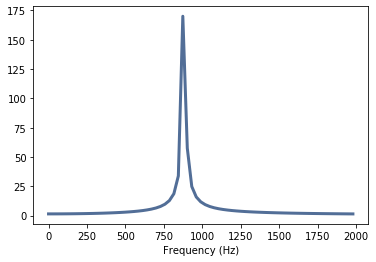

In [2]:
signal = thinkdsp.SinSignal(freq=880)
duration = signal.period * 30.25
wave = signal.make_wave(duration)
spectrum = wave.make_spectrum()

spectrum.plot(high=2000)
thinkplot.config(xlabel='Frequency (Hz)')

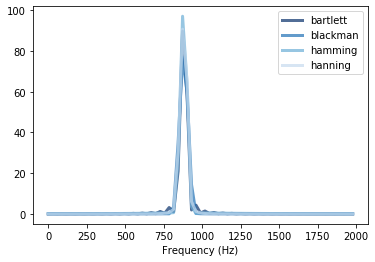

In [3]:
thinkplot.preplot(4)

for window_func in [np.bartlett, np.blackman, np.hamming, np.hanning]:
    wave = signal.make_wave(duration)
    wave.ys *= window_func(len(wave.ys))

    spectrum = wave.make_spectrum()
    spectrum.plot(high=2000, label=window_func.__name__)

thinkplot.config(xlabel='Frequency (Hz)', legend=True)

Exercise

Write a class called SawtoothChirp that extends Chirp and overrides evaluate to generate a sawtooth waveform with frequency that increases (or decreases) linearly.


In [4]:
import math
PI2 = 2 * math.pi

class SawtoothChirp(thinkdsp.Chirp):
    """Represents a sawtooth signal with varying frequency."""

    def _evaluate(self, ts, freqs):
        """Helper function that evaluates the signal.

        ts: float array of times
        freqs: float array of frequencies during each interval
        """
        dts = np.diff(ts)
        dps = PI2 * freqs * dts
        phases = np.cumsum(dps)
        phases = np.insert(phases, 0, 0)
        cycles = phases / PI2
        frac, _ = np.modf(cycles)
        ys = thinkdsp.normalize(thinkdsp.unbias(frac), self.amp)
        return ys

In [5]:
signal = SawtoothChirp(start=200, end=800)
wave = signal.make_wave(duration=1, framerate=15000)
wave.apodize()
wave.make_audio()

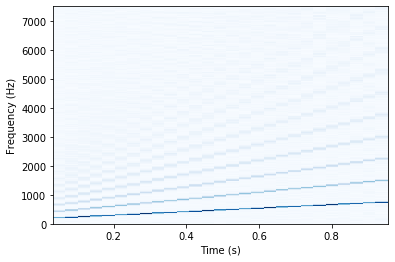

In [6]:
sp = wave.make_spectrogram(1024)
sp.plot()
thinkplot.config(xlabel='Time (s)', ylabel='Frequency (Hz)')

Exercise

Make a sawtooth chirp that sweeps from 2500 to 3000 Hz, then make a wave with duration 1 and framerate 20 kHz. Draw a sketch of what you think the spectrum will look like. Then plot the spectrum and see if you got it right.

In [7]:
signal = SawtoothChirp(start=2500, end=3000)
wave = signal.make_wave(duration=1, framerate=20000)
wave.make_audio()

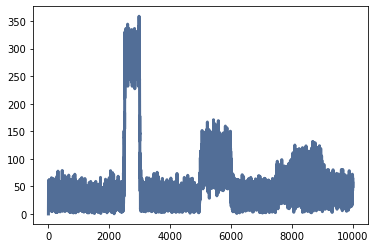

In [8]:
wave.make_spectrum().plot()

Exercise

In musical terminology, a “glissando” is a note that slides from one pitch to another, so it is similar to a chirp. Find or make a recording of a glissando and plot its spectrogram.

One suggestion: George Gershwin's Rhapsody in Blue starts with a famous clarinet glissando; you can download a recording from http://archive.org/details/rhapblue11924.


In [9]:
url01= 'https://ia800200.us.archive.org/29/items/KristenMerinskyYesterday/yesterdayh.mp3'

import IPython.display as dp
dp.Audio(url= url01)

mp3File= 'yesterdayh.mp3'
#wave = thinkdsp.read_wave(mp3File)

In [11]:
from os import path
from pydub import AudioSegment

# files                                                                         
src = mp3File #"transcript.mp3"
dst = wavFile = 'yesterdayh.wav' #"test.wav"

# convert wav to mp3                                                            
sound = AudioSegment.from_mp3(src)
sound.export(dst, format="wav")

<_io.BufferedRandom name='yesterdayh.wav'>

In [12]:
wave = thinkdsp.read_wave(dst) 
wave.make_audio()

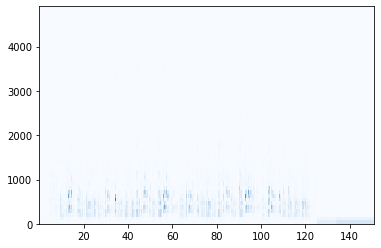

In [13]:
wave.make_spectrogram(512).plot(high=5000)

In [14]:
seg01= wave.segment(start= 2, duration= 5)
seg01.make_audio()

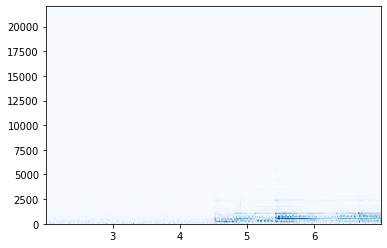

In [15]:
seg01.make_spectrogram(512).plot()

Exercise

A trombone player can play a glissando by extending the trombone slide while blowing continuously. As the slide extends, the total length of the tube gets longer, and the resulting pitch is inversely proportional to length. Assuming that the player moves the slide at a constant speed, how does frequency vary with time?

Write a class called TromboneGliss that extends Chirp and provides evaluate. Make a wave that simulates a trombone glissando from F3 down to C3 and back up to F3. C3 is 262 Hz; F3 is 349 Hz.

Plot a spectrogram of the resulting wave. Is a trombone glissando more like a linear or exponential chirp?


In [16]:
class TromboneGliss(thinkdsp.Chirp):
    """Represents a trombone-like signal with varying frequency."""
    
    def evaluate(self, ts):
        """Evaluates the signal at the given times.

        ts: float array of times
        
        returns: float wave array
        """
        l1, l2 = 1.0 / self.start, 1.0 / self.end
        lengths = np.linspace(l1, l2, len(ts)-1)
        freqs = 1 / lengths
        return self._evaluate(ts, freqs)

In [17]:
low=  262 
high= 349 
signal = TromboneGliss(high, low)
wave1 = signal.make_wave(duration=1)
wave1.apodize()
wave1.make_audio()

In [18]:
signal = TromboneGliss(low, high)
wave2 = signal.make_wave(duration=1)
wave2.apodize()
wave2.make_audio()

In [19]:
wave = wave1 | wave2  | wave2 | wave1 | wave1 | wave2  | wave2 | wave1
wave.make_audio()

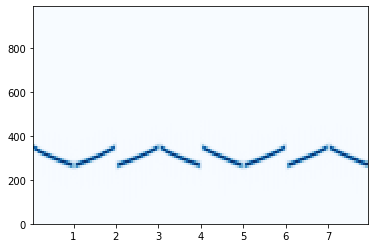

In [20]:
sp = wave.make_spectrogram(1024)
sp.plot(high=1000)

Exercise

Make or find a recording of a series of vowel sounds and look at the spectrogram. Can you identify different vowels?


In [21]:
wave = thinkdsp.read_wave('jazz-piano-intro.wav')
wave.make_audio()

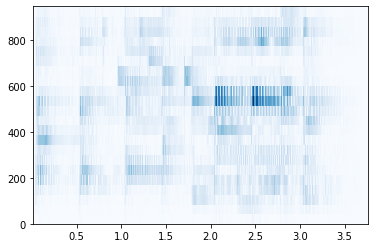

In [22]:
wave.make_spectrogram(1024).plot(high=1000)

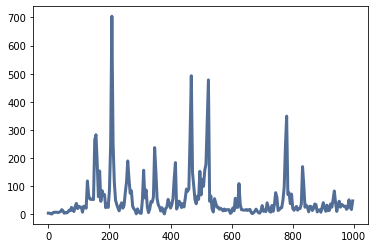

In [23]:
high = 1000
thinkplot.preplot(5)

segment = wave.segment(start=0.5, duration=0.25)
segment.make_spectrum().plot(high=high)

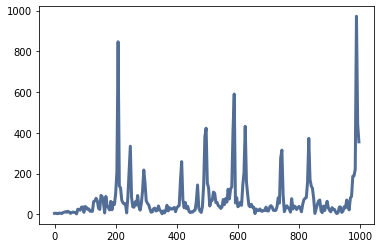

In [24]:
segment = wave.segment(start=1, duration=0.25)
segment.make_spectrum().plot(high=high)

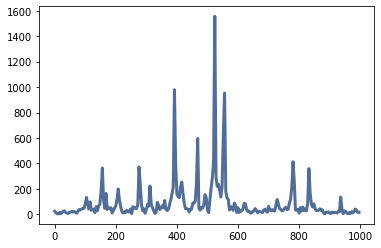

In [25]:
segment = wave.segment(start=2, duration=0.25)
segment.make_spectrum().plot(high=high)

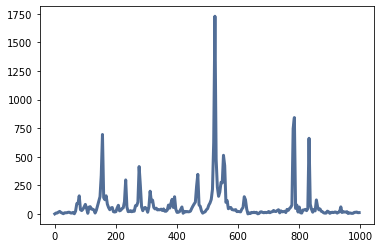

In [26]:
segment = wave.segment(start=2.5, duration=0.25)
segment.make_spectrum().plot(high=high)

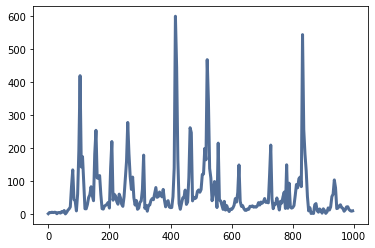

In [27]:
segment = wave.segment(start=3, duration=0.25)
segment.make_spectrum().plot(high=high)

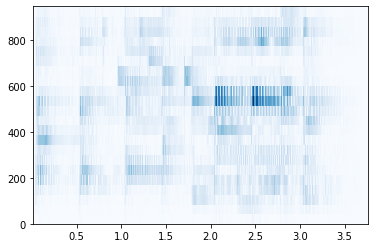

In [28]:
wave.make_spectrogram(1024).plot(high=1000)

In [30]:
a= wave.segment(start=.4, duration=.5)
a.make_audio()
e= wave.segment(start=.8, duration=.5)
e.make_audio()
i= wave.segment(start=1.2, duration=.5)
i.make_audio()
o= wave.segment(start=1.6, duration=.5)
o.make_audio()
u= wave.segment(start=2.2, duration=.5)
u.make_audio()

In [31]:
w1= a|i|u|o|e
w1.make_audio()

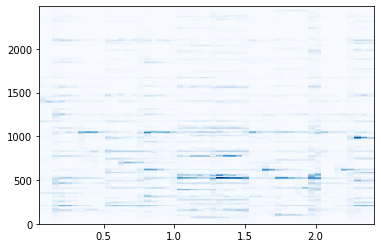

In [32]:
w1.make_spectrogram(4096).plot(high=2500)

In [33]:
w2= e|o|u|i|a
w2.make_audio()

In [34]:
w3= w1|w2|w1|w2
w3.make_audio()

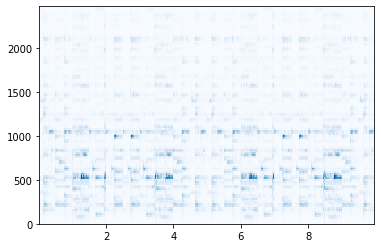

In [35]:
w3.make_spectrogram(2048).plot(high=2500)